In [ ]:
from fish_helpers import *
base_path = '/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/'
image_metadata = Metadata(base_path)
posnames = image_metadata.posnames
acqs = image_metadata.acqnames

In [2]:
""" Max Projection"""
from PIL import Image
import torch
import multiprocessing
from functools import partial
from scipy.ndimage import gaussian_filter
import time
def generate_img(data,FF=''):
    try:
        acq = data['acq']
        posname = data['posname']
        image_metadata = data['image_metadata']
        # scale = data['scale']
        channel = data['channel']
        # img = image_metadata.stkread(Position=posname,Channel=channel,acq=acq).max(axis=2).astype(float)
        if 'hybe' in acq:
            strip = 'strip' + acq.split('hybe')[1].split('_')[0] + '_' +str(int(acq.split('_')[1])-1)
        if not isinstance(FF,str):
            img = FF*image_metadata.stkread(Position=posname,Channel=channel,acq=acq).max(axis=2).astype(float)
        else:
            img = image_metadata.stkread(Position=posname,Channel=channel,acq=acq).max(axis=2).astype(float)
            if 'hybe' in acq:
                bkg = image_metadata.stkread(Position=posname,Channel=channel,acq=strip).max(axis=2).astype(float)
                img = img-bkg
        
        # img = np.array(Image.fromarray(img).resize((scale[0],scale[1]), Image.BICUBIC))
        return posname,img
    except Exception as e:
        print(e)
        print(posname)
        img = np.zeros([2048, 2448]).astype(float)
        # img = np.array(Image.fromarray(np.zeros([2048, 2448]).astype(float)).resize((scale[0],scale[1]), Image.BICUBIC))
        return posname,img

In [3]:
from scipy.ndimage import gaussian_filter
import torch
def generate_FF(image_metadata,acq,channel):
    posnames = image_metadata.image_table[image_metadata.image_table.acq==acq].Position.unique()
    random_posnames = posnames[0:20]#np.random.choice(posnames,20)
    FF = torch.dstack([torch.tensor(image_metadata.stkread(Position=posname,Channel=channel,acq=acq).min(2).astype(float)) for posname in random_posnames]).min(2).values
    FF = gaussian_filter(FF.numpy(),5)
    FF = FF.mean()/FF
    #Display(1/FF,rel_min=1,rel_max=99,colorbar=True)
    return FF

In [4]:
def generate_stitched(image_metadata,acq,channel,pixel_size=0.495,n_pixels=np.array([2448, 2048]),dtype = torch.int32,verbose=True):
    posnames = image_metadata.image_table[image_metadata.image_table.acq==acq].Position.unique()
    FF = generate_FF(image_metadata,acq,channel)
    coordinates = {}
    for posname in posnames:
        coordinates[posname] = (image_metadata.image_table[(image_metadata.image_table.acq==acq)&(image_metadata.image_table.Position==posname)].XY.iloc[0]/pixel_size).astype(int)
    xy = np.stack([pxy for i,pxy in coordinates.items()])
    #scale = (pixel_size*n_pixels).astype(int)
    y_min,x_min = xy.min(0)-n_pixels#((np.stack(image_metadata.image_table.XY).min(0)-scale)/pixel_size).astype(int)
    y_max,x_max = xy.max(0)+(2*n_pixels)#((np.stack(image_metadata.image_table.XY).max(0)+2*scale)/pixel_size).astype(int)
    x_range = np.array(range(x_min,x_max+1))
    y_range = np.array(range(y_min,y_max+1))
    stitched = torch.tensor(np.zeros([len(x_range),len(y_range)]),dtype=dtype)
    img_dict = {}
    Input = []
    for posname in np.unique(posnames):
        data = {}
        data['acq'] = acq
        data['posname'] = posname
        data['image_metadata'] = image_metadata
        # data['scale'] = n_pixels
        data['channel'] = channel
        Input.append(data)
    pfunc = partial(generate_img)
    with multiprocessing.Pool(60) as p:
        if verbose:
            iterable = tqdm(p.imap(pfunc,Input),total=len(Input),desc='Generate Images '+acq+'_'+channel)
        else:
            iterable = p.imap(pfunc,Input)
        for posname,image in iterable:
            try:
                position_y,position_x = coordinates[posname].astype(int)#xy[posnames==posname,:].astype(int)[0]
                #torch.tensor(np.array(np.fliplr(np.flipud(image.T))))
                img = torch.tensor(np.array(np.flipud(np.rot90(np.array(image),3))),dtype=dtype)
                img_x_min = position_x-x_min
                img_x_max = (position_x-x_min)+img.shape[0]
                img_y_min = position_y-y_min
                img_y_max = (position_y-y_min)+img.shape[1]
                img = torch.stack([img,stitched[img_x_min:img_x_max,img_y_min:img_y_max]]).max(0).values
                stitched[img_x_min:img_x_max,img_y_min:img_y_max] = img.type(dtype)#torch.tensor(np.array(np.fliplr(np.flipud(image.T))))
            except Exception as e:
                print(e)
                print(posname)
                # raise
                continue
    # stitched = stitched[:,stitched.max(0)>0]
    # stitched = stitched[stitched.max(1)>0,:]
    return stitched.numpy()

In [1]:
import importlib
cword_config = 'dredfish_config'
config = importlib.import_module(cword_config)
bitmap = config.bitmap
bitmap

[('RS0109_cy5', 'hybe2', 'FarRed'),
 ('RS0175_cy5', 'hybe3', 'FarRed'),
 ('RS0237_cy5', 'hybe4', 'FarRed'),
 ('RS0307_cy5', 'hybe5', 'FarRed'),
 ('RS0332_cy5', 'hybe6', 'FarRed'),
 ('RS0384_atto565', 'hybe10', 'FarRed'),
 ('RS0406_atto565', 'hybe11', 'FarRed'),
 ('RS0451_atto565', 'hybe12', 'FarRed'),
 ('RS0468_atto565', 'hybe13', 'FarRed'),
 ('RS0548_atto565', 'hybe14', 'FarRed'),
 ('RS64.0_atto565', 'hybe15', 'FarRed'),
 ('RS156.0_alexa488', 'hybe19', 'FarRed'),
 ('RS278.0_alexa488', 'hybe20', 'FarRed'),
 ('RS313.0_alexa488', 'hybe21', 'FarRed'),
 ('RS643.0_alexa488', 'hybe22', 'FarRed'),
 ('RS740.0_alexa488', 'hybe23', 'FarRed'),
 ('RS810.0_alexa488', 'hybe24', 'FarRed'),
 ('RSN9927.0_cy5', 'hybe7', 'FarRed'),
 ('RSN2336.0_cy5', 'hybe8', 'FarRed'),
 ('RSN1807.0_cy5', 'hybe9', 'FarRed'),
 ('RSN4287.0_atto565', 'hybe16', 'FarRed'),
 ('RSN1252.0_atto565', 'hybe17', 'FarRed'),
 ('RSN9535.0_atto565', 'hybe18', 'FarRed'),
 ('RS0095_cy5', 'hybe1', 'FarRed')]

In [6]:
image_metadata.acqnames

array(['acq_1', 'hybe1_3', 'strip1_2', 'strip2_4', 'hybe2_5', 'strip3_6',
       'hybe3_7', 'strip4_8', 'hybe4_9', 'strip5_10', 'hybe5_11',
       'hybe6_13', 'strip6_12', 'hybe7_15', 'strip7_14', 'strip8_16',
       'hybe8_17', 'strip9_18', 'hybe9_19', 'strip10_20', 'hybe10_21',
       'strip11_22', 'hybe11_23', 'hybe12_25', 'strip12_24', 'strip13_26',
       'hybe13_27', 'strip14_28', 'hybe14_29', 'strip15_30', 'hybe15_31',
       'hybe16_33', 'strip16_32', 'hybe17_35', 'strip17_34', 'strip18_36',
       'hybe18_37', 'strip19_38', 'hybe19_39', 'strip20_40', 'hybe20_41',
       'hybe21_43', 'strip21_42', 'hybe22_45', 'strip22_44', 'strip23_46',
       'hybe23_47', 'strip24_48', 'hybe24_49', 'background_50',
       'nucstain_51'], dtype=object)

In [ ]:
import cv2
out_path = os.path.join(base_path,'results')
if not os.path.exists(out_path):
    os.mkdir(out_path)
for i,(r,h,c) in enumerate(bitmap):
    print('bit'+str(i))
    acq = [i for i in image_metadata.acqnames if i.split('_')[0]==h][-1]
    stitched = generate_stitched(image_metadata,acq,c,pixel_size=0.326)
    stitched[stitched<0] = 0
    fname = os.path.join(out_path,'bit'+str(i)+'_stitched.tif')
    cv2.imwrite(fname, stitched.astype('uint16'))
""" Background """
acq = [i for i in image_metadata.acqnames if i.split('_')[0]=='nucstain'][-1]
stitched = generate_stitched(image_metadata,acq,'FarRed',pixel_size=0.326)
stitched[stitched<0] = 0
fname = os.path.join(out_path,'background_stitched.tif')
cv2.imwrite(fname, stitched.astype('uint16'))
stitched = generate_stitched(image_metadata,acq,'DeepBlue',pixel_size=0.326)
stitched[stitched<0] = 0
fname = os.path.join(out_path,'nucstain_stitched.tif')
cv2.imwrite(fname, stitched.astype('uint16'))

bit0


Generate Images hybe2_5_FarRed: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:45<00:00,  2.65it/s]


bit1


Generate Images hybe3_7_FarRed: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:57<00:00,  2.09it/s]


bit2


Generate Images hybe4_9_FarRed: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [01:20<00:00,  1.50it/s]


bit3


Generate Images hybe5_11_FarRed:   5%|████████▍                                                                                                                                                               | 6/120 [00:38<14:57,  7.87s/it]

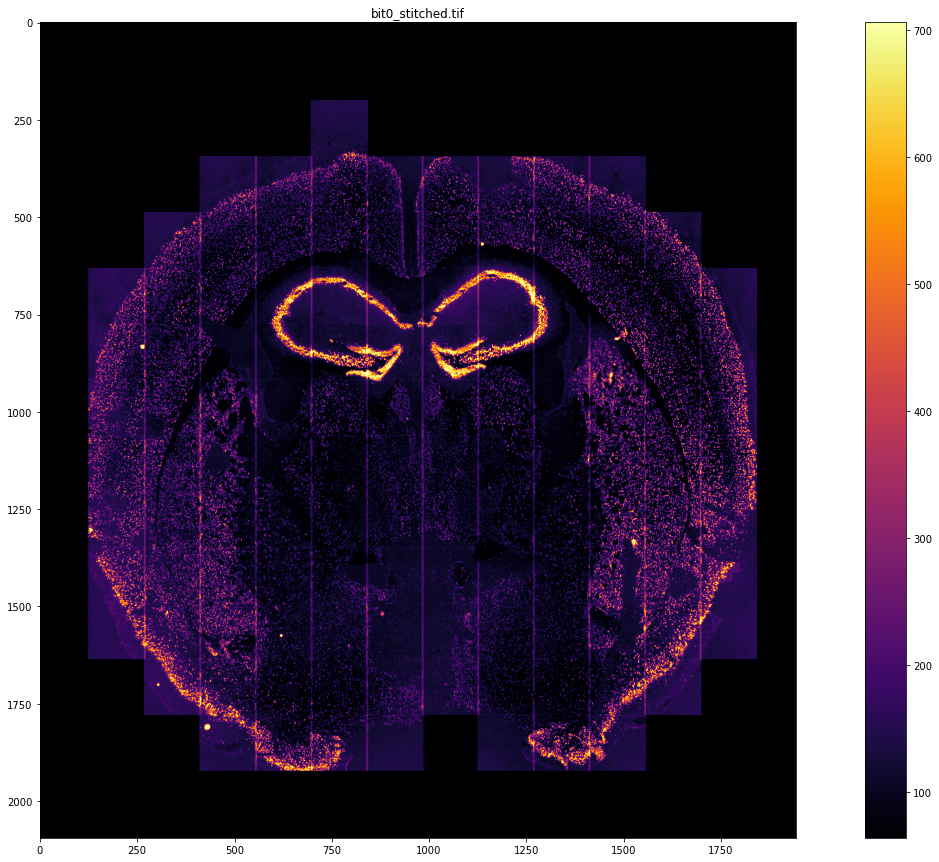

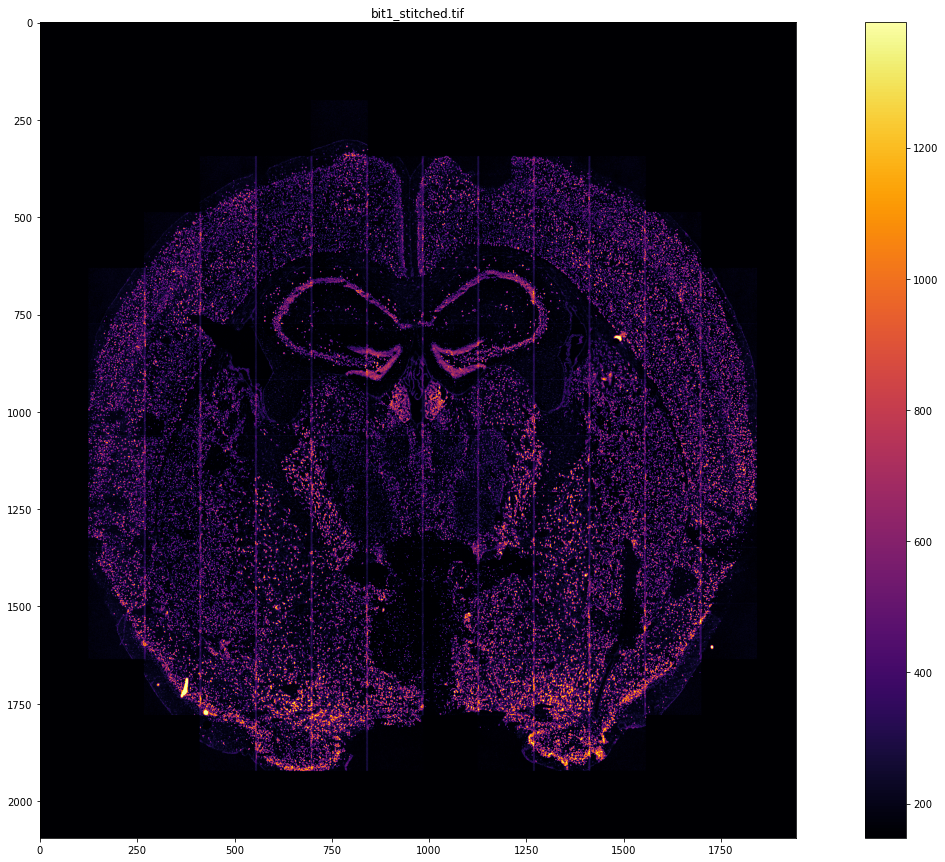

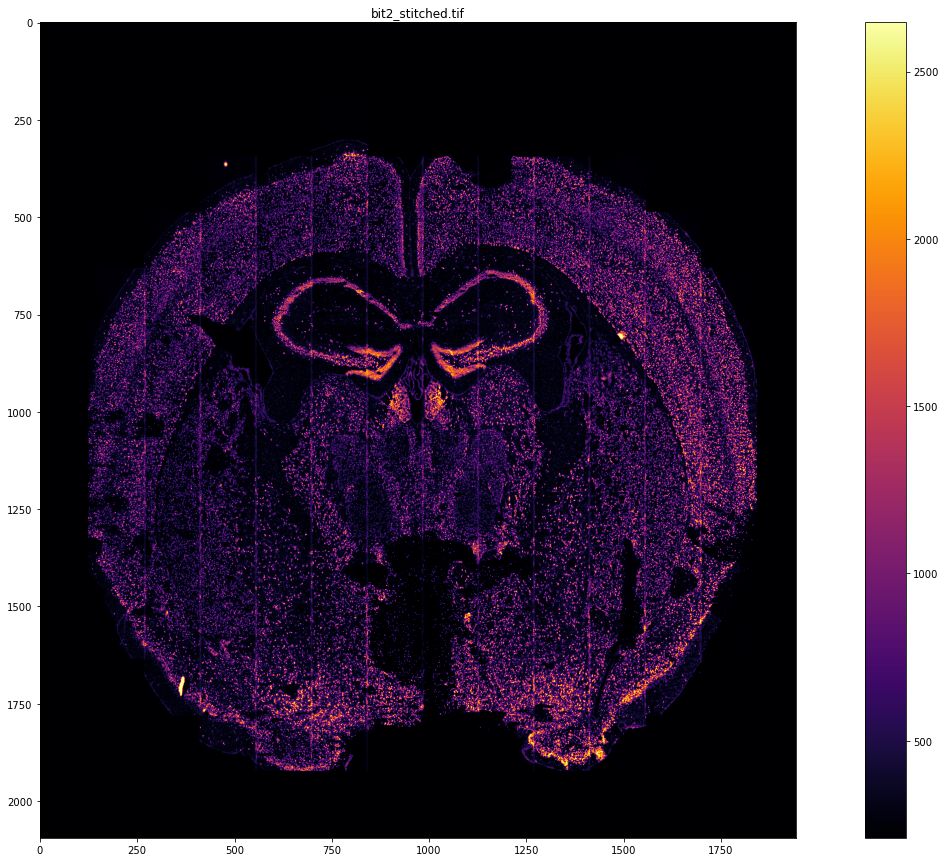

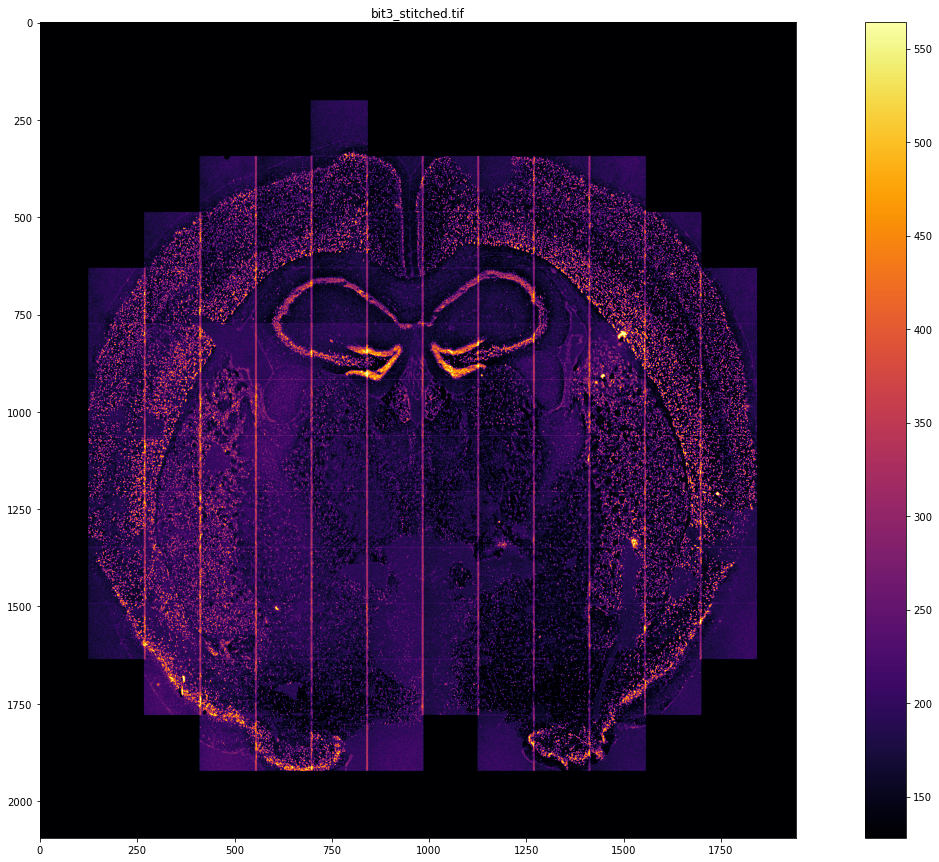

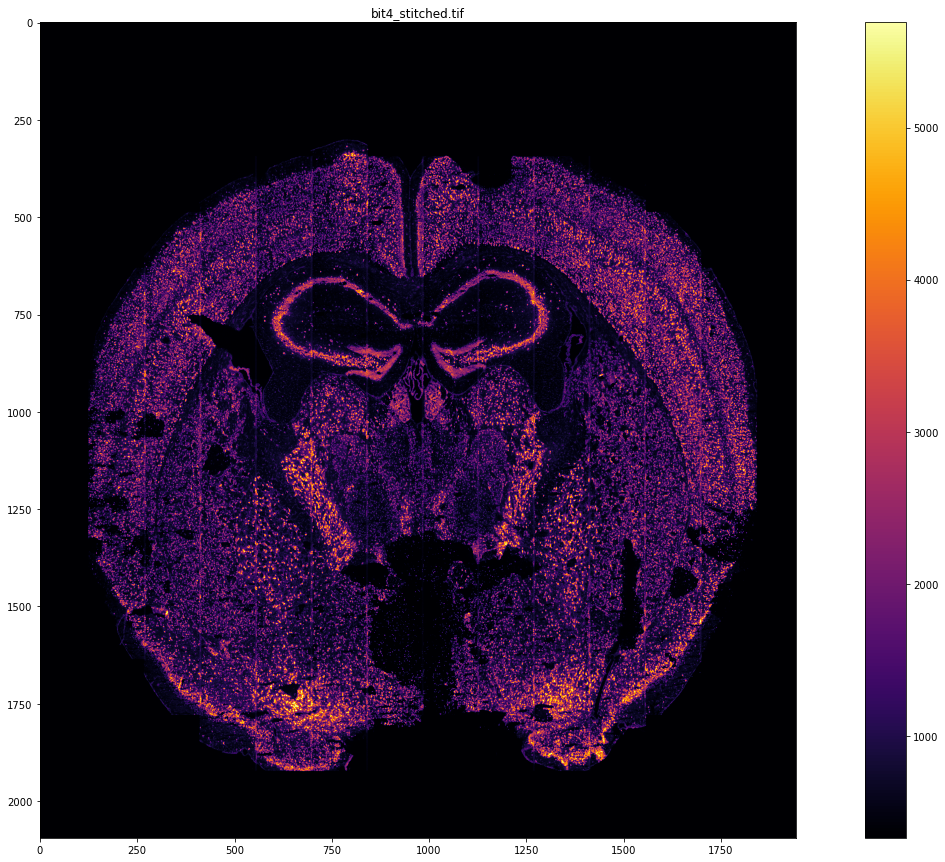

...

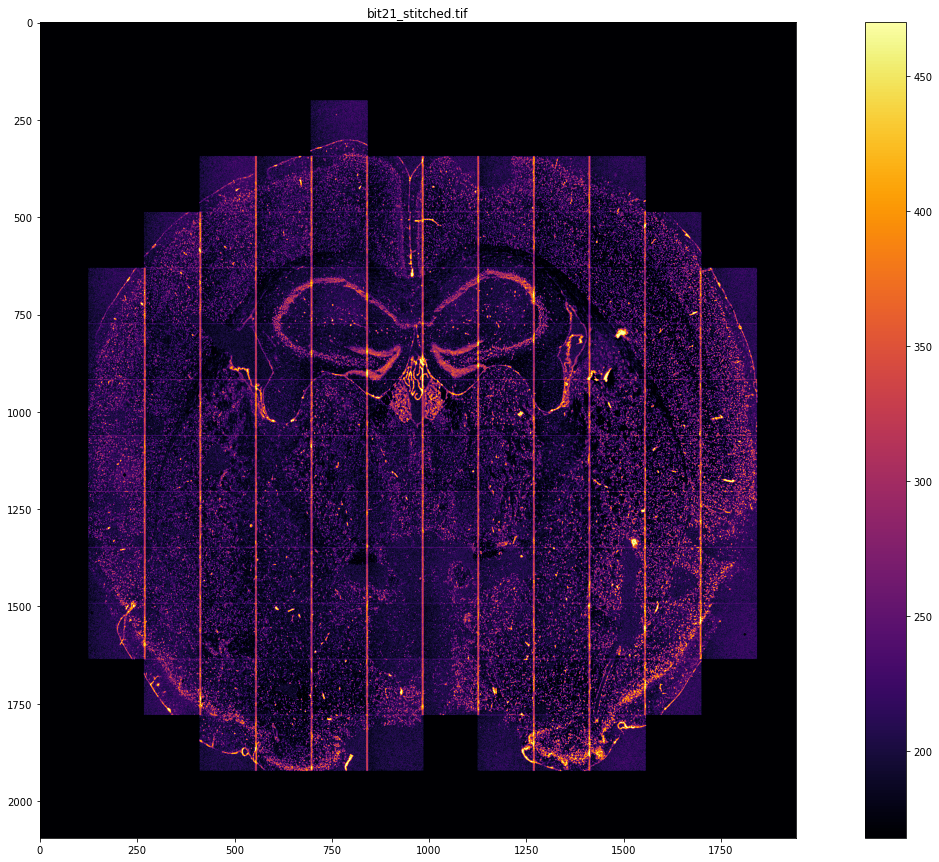

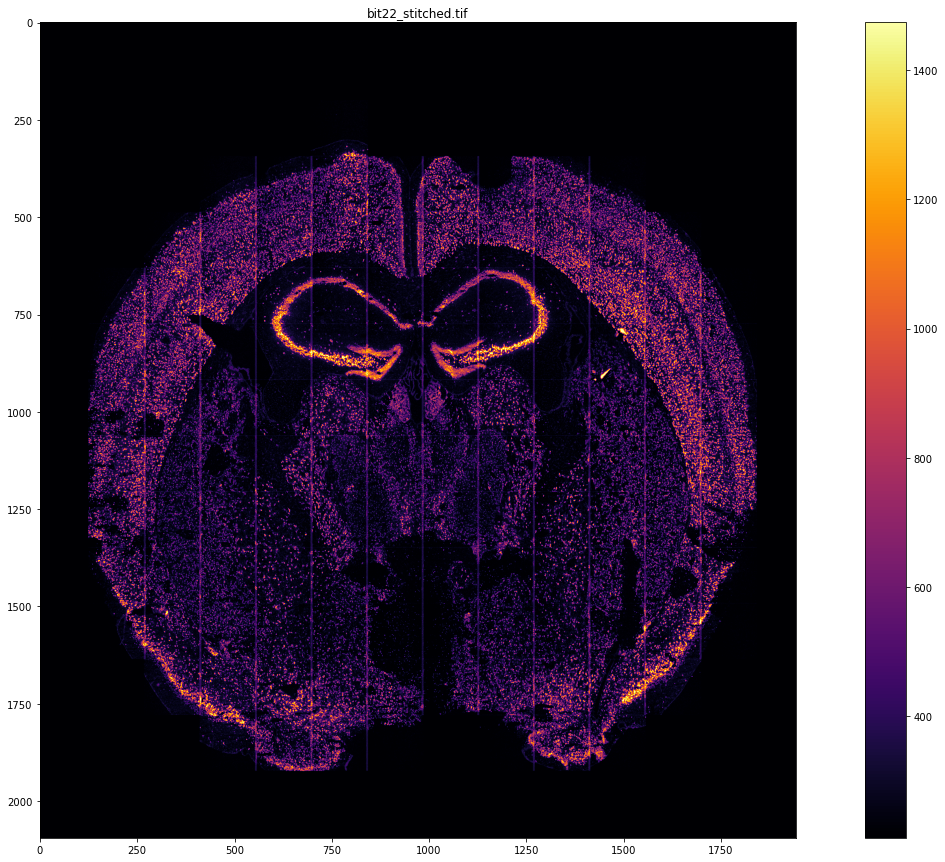

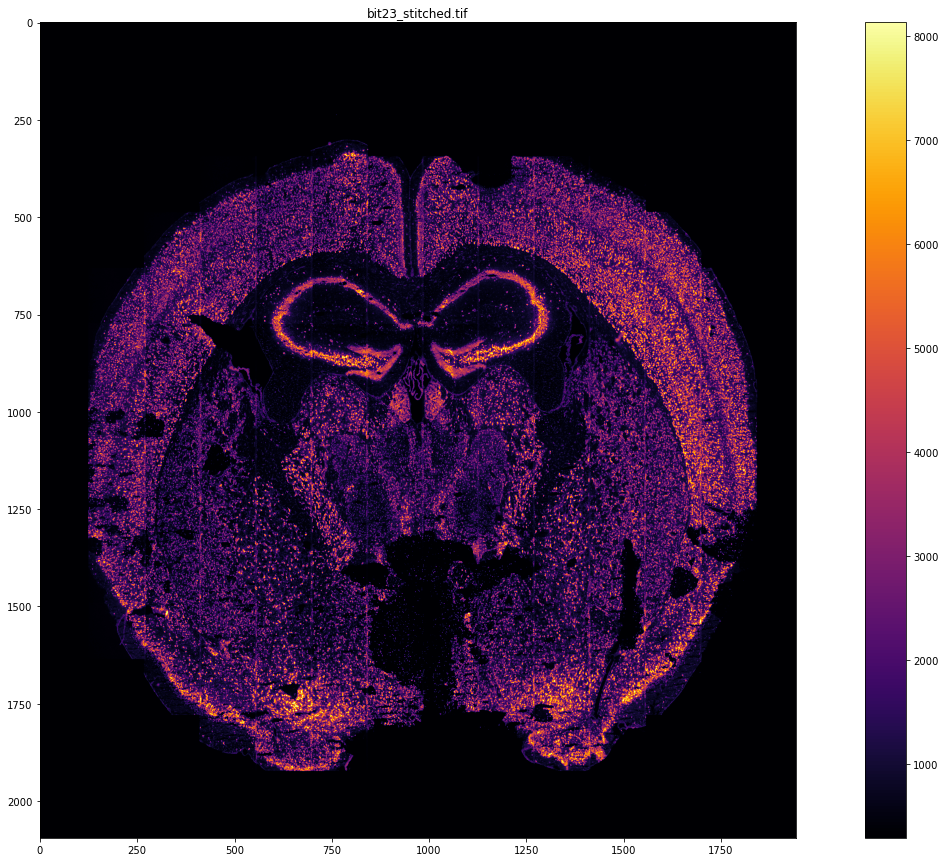

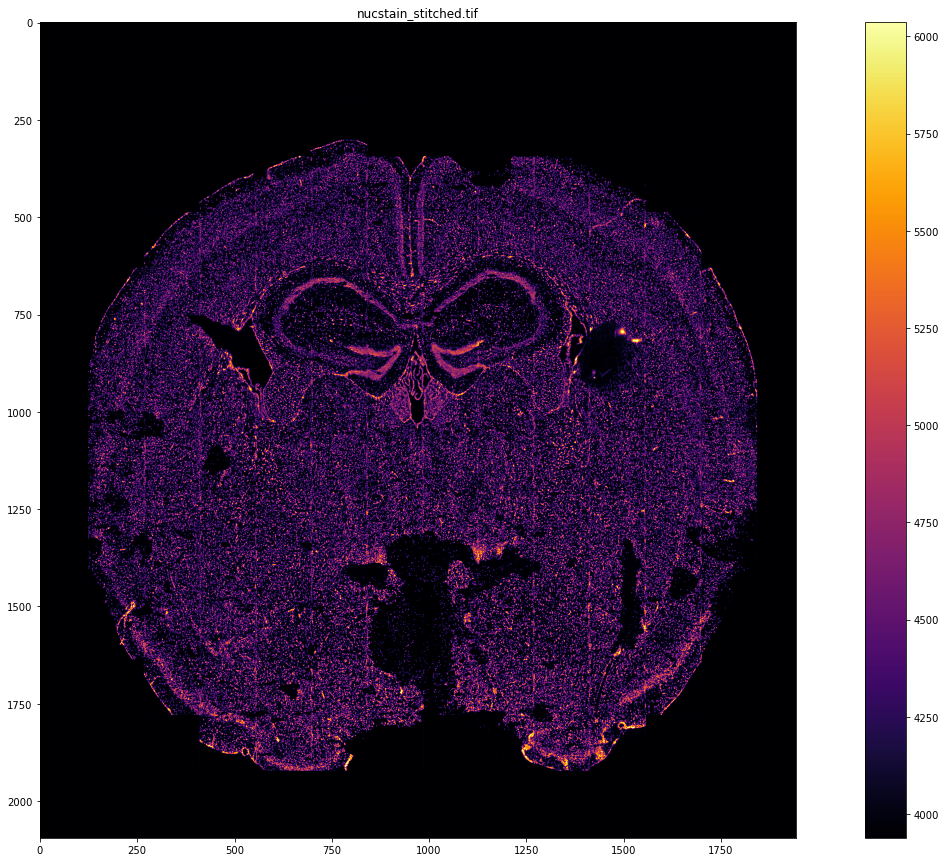

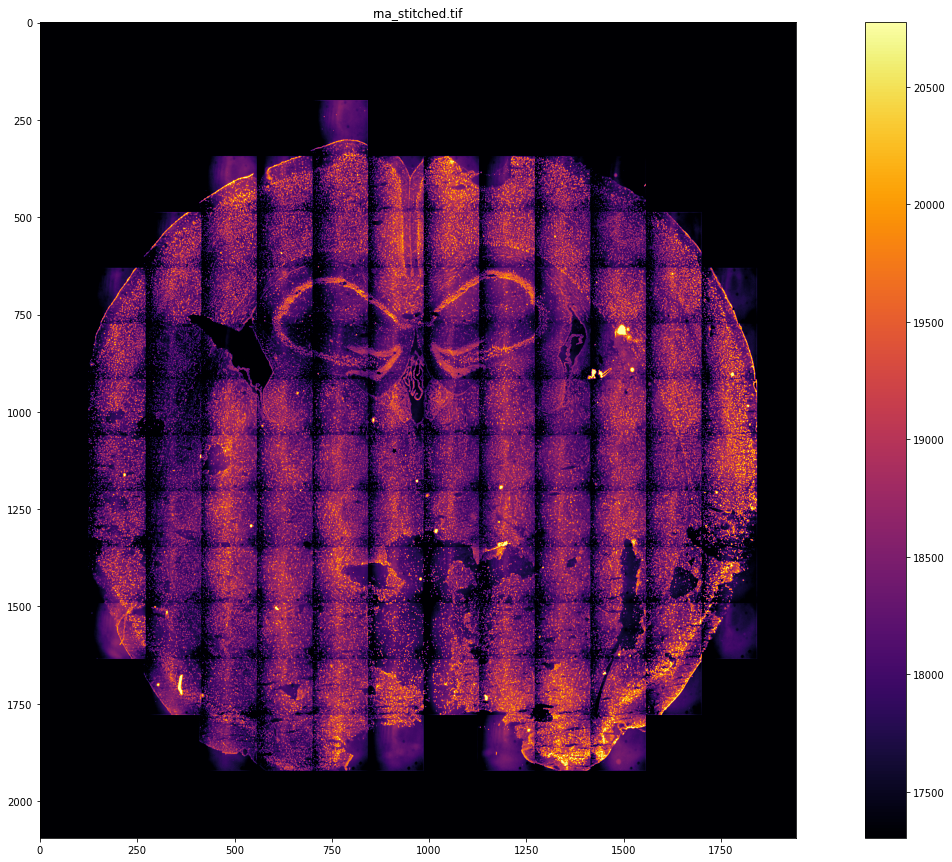

In [3]:
from fish_helpers import *
base_path = '/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/'
import cv2
out_path = os.path.join(base_path,'results')
for file in os.listdir(out_path):
    if not '_stitched.tif' in file:
        continue
    if 'um_stitched.tif' in file:
        continue
    fname = os.path.join(out_path,file)
    stitched = dout = cv2.imread(fname,-1)
    """ Downsample to 25 um pixel size """
    from PIL import Image
    img = stitched.copy()
    in_pixel_size = 0.326
    out_pixel_size = 5
    ratio = in_pixel_size/out_pixel_size
    scale = (np.array(img.shape)*ratio).astype(int)
    img = np.array(Image.fromarray(img.astype(float)).resize((scale[0],scale[1]), Image.BICUBIC))
    img = np.rot90(img,1)
    """ Visualize """ 
    img[img<0] = 0
    img = img.astype('uint16')
    s = img.ravel()
    s = s[s>0]
    vmin = np.percentile(s,10)
    vmax = np.percentile(s,99)
    img[img<vmin] = vmin
    img[img>vmax] = vmax
    plt.figure(figsize=[25,15])
    plt.title(file)
    plt.imshow(img,cmap='inferno')#,vmin=np.percentile(s,10),vmax=np.percentile(s,99))
    plt.colorbar()
    plt.show()
    """ Save """
    fname = os.path.join(out_path,file.split('_stitched')[0]+'_'+str(out_pixel_size)+'um_stitched.tif')
    cv2.imwrite(fname, img.astype('uint16'))

In [4]:
stitched = generate_stitched(image_metadata,'hybe1_3','FarRed',pixel_size=0.326)
# stitched = stitched[stitched.max(1)>0,:]
# stitched = stitched[:,stitched.max(0)>0]
s = stitched.ravel()
s = s[s>0]
plt.figure(figsize=[25,15])
plt.imshow(stitched,cmap='inferno',vmin=np.percentile(s,10),vmax=np.percentile(s,99))
plt.colorbar()
plt.show()

NameError: name 'generate_stitched' is not defined

In [5]:
image_metadata.acqnames

array(['acq_1', 'hybe1_3', 'strip1_2', 'strip2_4', 'hybe2_5', 'strip3_6',
       'hybe3_7', 'strip4_8', 'hybe4_9', 'strip5_10', 'hybe5_11',
       'hybe6_13', 'strip6_12', 'hybe7_15', 'strip7_14', 'strip8_16',
       'hybe8_17', 'strip9_18', 'hybe9_19', 'strip10_20', 'hybe10_21',
       'strip11_22', 'hybe11_23', 'hybe12_25', 'strip12_24', 'strip13_26',
       'hybe13_27', 'strip14_28', 'hybe14_29', 'strip15_30', 'hybe15_31',
       'hybe16_33', 'strip16_32', 'hybe17_35', 'strip17_34', 'strip18_36',
       'hybe18_37', 'strip19_38', 'hybe19_39', 'strip20_40', 'hybe20_41',
       'hybe21_43', 'strip21_42', 'hybe22_45', 'strip22_44', 'strip23_46',
       'hybe23_47', 'strip24_48', 'hybe24_49', 'background_50',
       'nucstain_51'], dtype=object)

In [6]:
stitched1 = generate_stitched(image_metadata,'nucstain_51','FarRed',pixel_size=0.326)
stitched2 = generate_stitched(image_metadata,'hybe1_3','FarRed',pixel_size=0.326)
stitched3 = generate_stitched(image_metadata,'hybe5_11','FarRed',pixel_size=0.326)

Generate Images hybe5_11_FarRed: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:47<00:00,  2.50it/s]


In [8]:
stitched4 = generate_stitched(image_metadata,'nucstain_51','DeepBlue',pixel_size=0.326)

Generate Images nucstain_51_DeepBlue: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [00:50<00:00,  2.36it/s]


In [7]:
import napari

In [13]:
import napari
napari.view_image(stitched1)

/home/zach/miniconda3/envs/dredfish_3.9/lib/python3.9/site-packages/napari/_vispy/layers/image.py:233: UserWarning: data shape (32144, 29789) exceeds GL_MAX_TEXTURE_SIZE 8192 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(
/home/zach/miniconda3/envs/dredfish_3.9/lib/python3.9/site-packages/napari/_vispy/layers/image.py:233: UserWarning: data shape (32144, 29789) exceeds GL_MAX_TEXTURE_SIZE 8192 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(


Viewer(axes=Axes(visible=False, labels=True, colored=True, dashed=False, arrows=True), camera=Camera(center=(0.0, 16071.5, 14894.0), zoom=0.01926953708312593, angles=(0.0, 0.0, 90.0), perspective=0.0, interactive=True), cursor=Cursor(position=(1.0, 1.0), scaled=True, size=1, style=<CursorStyle.STANDARD: 'standard'>), dims=Dims(ndim=2, ndisplay=2, last_used=0, range=((0.0, 32144.0, 1.0), (0.0, 29789.0, 1.0)), current_step=(16072, 14894), order=(0, 1), axis_labels=('0', '1')), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Image layer 'stitched1' at 0x7ff66f4bd850>], scale_bar=ScaleBar(visible=False, colored=False, ticks=True, position=<Position.BOTTOM_RIGHT: 'bottom_right'>, font_size=10.0, unit=None), text_overlay=TextOverlay(visible=False, color=array([0.5, 0.5, 0.5, 1. ]), font_size=10.0, position=<TextOverlayPosition.TOP_LEFT: 'top_left'>, text=''), overlays=Overlays(interaction_box=InteractionBox(points=None, show=False, show_handle=False, show_vertices=False, s

In [14]:
napari.view_image(stitched4)

/home/zach/miniconda3/envs/dredfish_3.9/lib/python3.9/site-packages/napari/_vispy/layers/image.py:233: UserWarning: data shape (32144, 29789) exceeds GL_MAX_TEXTURE_SIZE 8192 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(
/home/zach/miniconda3/envs/dredfish_3.9/lib/python3.9/site-packages/napari/_vispy/layers/image.py:233: UserWarning: data shape (32144, 29789) exceeds GL_MAX_TEXTURE_SIZE 8192 in at least one axis and will be downsampled. Rendering is currently in 2D mode.
  warnings.warn(


Viewer(axes=Axes(visible=False, labels=True, colored=True, dashed=False, arrows=True), camera=Camera(center=(0.0, 16071.5, 14894.0), zoom=0.01926953708312593, angles=(0.0, 0.0, 90.0), perspective=0.0, interactive=True), cursor=Cursor(position=(1.0, 1.0), scaled=True, size=1, style=<CursorStyle.STANDARD: 'standard'>), dims=Dims(ndim=2, ndisplay=2, last_used=0, range=((0.0, 32144.0, 1.0), (0.0, 29789.0, 1.0)), current_step=(16072, 14894), order=(0, 1), axis_labels=('0', '1')), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Image layer 'stitched4' at 0x7ff66f251280>], scale_bar=ScaleBar(visible=False, colored=False, ticks=True, position=<Position.BOTTOM_RIGHT: 'bottom_right'>, font_size=10.0, unit=None), text_overlay=TextOverlay(visible=False, color=array([0.5, 0.5, 0.5, 1. ]), font_size=10.0, position=<TextOverlayPosition.TOP_LEFT: 'top_left'>, text=''), overlays=Overlays(interaction_box=InteractionBox(points=None, show=False, show_handle=False, show_vertices=False, s